# plot intensity variance vs nuclear size for 3D images


In [1]:
import napari
import torch
from skimage.measure import regionprops_table, regionprops
import scipy as sp
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import glob
import os
from matplotlib_scalebar.scalebar import ScaleBar
import gc
import seaborn as sns
from sklearn.mixture import GaussianMixture
from bioio import BioImage
import bioio_nd2
import bioio_tifffile
from bioio.writers import OmeTiffWriter


anisotropy = (3.2,1,1) # Relative scale of (Z,X,Y) axes

nucChannel = 0 # red emerin rings
spotChannel = 1 # green spots

# in lucien's original scripts:
# channel 0 is green spots
# channel 1 is red emerin

pd.set_option('display.max_columns', None)

In [2]:

# on server
base_path = '/mnt/external.data/MeisterLab/jsemple/lhinder/segmentation_Dario/'
base_path = '/Volumes/external.data/MeisterLab/jsemple/lhinder/segmentation_Dario/'
df_paths = pd.DataFrame.from_dict({'data_path': [base_path+'/DPY27/1268/20240915_3d/',
            base_path+'/DPY27/1268/20240814_3d/',
            base_path+'/DPY27/1268/20240808_3d/',
            base_path+'/SDC1/1273/20240813_3d/',
            base_path+'/SDC1/1273/20240821_3d/']})

output_path=base_path+'/DPY27_SDC1_3d/'

if not os.path.exists(output_path+"/plots"):
    os.makedirs(output_path+"/plots")

df=pd.DataFrame()
dist=pd.DataFrame()
for path in df_paths['data_path']:
    df_tmp=pd.read_csv(path+"nuclei_analysis_v001.csv")
    df = pd.concat([df,df_tmp])

df.head()


,label,bb_dimZ,bb_dimY,bb_dimX,centroid_z,centroid_y,centroid_x,major_axis_length,solidity,mean,median,std,sum,variance,max,min,volume,id,zproj_spots,zproj_nuclei,filename,date,experiment,strain,protein,raw_filepath,denoised_filepath
0,1,3,332,196,10.237467,450.775726,209.588391,764.512529,0.087499,121.188654,121.0,9.385192,91861,88.081824,148,99,758,DPY27_3d_20240915_1268_E_bean_15um,[[ 0 126 122 ... 0 0 0]\n [123 125 118 ...,[[ 0 129 126 ... 0 0 0]\n [135 129 136 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...
1,2,13,51,48,17.092244,602.730192,235.823937,48.632410,0.728521,213.400834,205.0,61.361131,2558676,3765.188456,793,105,11990,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...
2,3,24,48,58,23.818743,465.149410,405.504229,59.554474,0.738189,227.012229,162.0,143.260306,5959071,20523.515241,1047,99,26250,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...
3,4,13,47,42,17.885833,526.404655,261.189650,47.890527,0.919311,208.377154,160.0,116.236053,3205049,13510.819916,854,99,15381,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...
4,5,10,47,50,16.749367,537.583875,332.809957,50.926443,0.926797,179.198181,142.0,93.185448,2620415,8683.527708,720,94,14623,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...


## Add some variables
Radius might scale more linearly than volume
Coefficient of variation is independent of the mean signal

In [3]:
def radiusFromVolume(volume):
    return (3*volume/(4*np.pi))**(1/3)

def coefficientOfVariation(std,mean):
    return std/mean


df['radius'] = radiusFromVolume(df['volume'])
df['cv'] = coefficientOfVariation(df['std'],df['mean'])
df['zx_ratio'] = (df['bb_dimZ']*anisotropy[0])/(df['bb_dimX']*anisotropy[2])
df['zy_ratio'] = (df['bb_dimZ']*anisotropy[0])/(df['bb_dimY']*anisotropy[1])
df['xy_ratio'] = (df['bb_dimX']*anisotropy[2])/(df['bb_dimY']*anisotropy[1])

df.head()
#sns.scatterplot(data=df, x="volume", y="radius")
#sns.scatterplot(data=df, x="mean", y="std")
#sns.scatterplot(data=df, x="mean", y="cv")

,label,bb_dimZ,bb_dimY,bb_dimX,centroid_z,centroid_y,centroid_x,major_axis_length,solidity,mean,median,std,sum,variance,max,min,volume,id,zproj_spots,zproj_nuclei,filename,date,experiment,strain,protein,raw_filepath,denoised_filepath,radius,cv,zx_ratio,zy_ratio,xy_ratio
0,1,3,332,196,10.237467,450.775726,209.588391,764.512529,0.087499,121.188654,121.0,9.385192,91861,88.081824,148,99,758,DPY27_3d_20240915_1268_E_bean_15um,[[ 0 126 122 ... 0 0 0]\n [123 125 118 ...,[[ 0 129 126 ... 0 0 0]\n [135 129 136 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,5.656227,0.077443,0.048980,0.028916,0.590361
1,2,13,51,48,17.092244,602.730192,235.823937,48.632410,0.728521,213.400834,205.0,61.361131,2558676,3765.188456,793,105,11990,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,14.198535,0.287539,0.866667,0.815686,0.941176
2,3,24,48,58,23.818743,465.149410,405.504229,59.554474,0.738189,227.012229,162.0,143.260306,5959071,20523.515241,1047,99,26250,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,18.436575,0.631069,1.324138,1.600000,1.208333
3,4,13,47,42,17.885833,526.404655,261.189650,47.890527,0.919311,208.377154,160.0,116.236053,3205049,13510.819916,854,99,15381,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,15.427610,0.557816,0.990476,0.885106,0.893617
4,5,10,47,50,16.749367,537.583875,332.809957,50.926443,0.926797,179.198181,142.0,93.185448,2620415,8683.527708,720,94,14623,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,15.169897,0.520013,0.640000,0.680851,1.063830


## Plotting functions



In [4]:
def histogramsOfVariables(df, variables):
    fig, axs = plt.subplots(len(variables)//5+(1 if len(variables)%5>0 else 0), 5, figsize=(12, 12))
    for i, var in enumerate(variables):
        sns.histplot(data=df, x=var, color='blue', ax=axs[i//5, i%5])
        axs[i//5, i%5].axvline(df[var].quantile(0.01), 0, 1, color='black', ls='--')
        axs[i//5, i%5].axvline(df[var].quantile(0.99), 0, 1, color='black', ls='--')
    fig.suptitle("histograms with 1st and 99th quantiles")
    plt.tight_layout()
    plt.show()

def plot_nuclei_crop(df, dataVar, top=True, nuclei=True, nb_nuc=100):
    '''Plot a cropped region of 100 nuclei with best or worst value from each image'''
    if top:
        extreme_n = df.nlargest(nb_nuc,dataVar)
    else:   
        extreme_n = df.nsmallest(nb_nuc,dataVar)
    fig, axs = plt.subplots(nb_nuc//10, 10, figsize=(10, 10))
    for i,index in enumerate(extreme_n.index):
        if nuclei:
            axs[i//10,i%10].imshow(df.iloc[index].zproj_nuclei)
        else:
            axs[i//10,i%10].imshow(df.iloc[index].zproj_spots)
        axs[i//10,i%10].title.set_text(np.round(df[dataVar].iloc[index],2))
    fig.suptitle(str("nuclei " if nuclei else "spots ")+dataVar+str(" top" if top else " bottom")+" values")
    plt.tight_layout()
    plt.show()


def plot_random_nuclei_crop(df, nuclei=True):
    '''Plot a cropped region of 100 random nuclei'''
    nb_nuc = 100
    np.random.seed(33)
    extreme_n = df.iloc[np.random.choice(range(len(df)),size = nb_nuc,replace = False)]
    fig, axs = plt.subplots(nb_nuc//10, 10, figsize=(10, 10))
    for i,index in enumerate(extreme_n.index):
        if nuclei:
            axs[i//10,i%10].imshow(df.iloc[index].zproj_nuclei)
        else:
            axs[i//10,i%10].imshow(df.iloc[index].zproj_spots)
        axs[i//10,i%10].title.set_text(index)
    fig.suptitle("Random "+str(" nuclei" if nuclei else " spots"))
    plt.tight_layout()
    plt.show()

def plotRegression(df,xVars,yVars):
    fig, axs = plt.subplots(len(xVars), len(yVars), figsize=(12, 6))
    for i in xVars:
        for j in yVars:
            r, p = sp.stats.pearsonr(x=df[i], y=df[j])
            sns.regplot(data=df, x=i, y=j, ax=axs[xVars.index(i),yVars.index(j)], robust=True, scatter_kws={'alpha':0.1,'s':10}, line_kws={'color':'red'})
            axs[xVars.index(i),yVars.index(j)].text(np.max(df[i])*0.8, np.max(df[j])*0.8, 'r={:.2f}'.format(r))
    plt.tight_layout()
    plt.show()


def plotScatter(df,xVars,yVars):
    fig, axs = plt.subplots(len(xVars), len(yVars), figsize=(12, 6))
    for i in xVars:
        for j in yVars:
            sns.scatterplot(data=df, x=i, y=j, ax=axs[xVars.index(i),yVars.index(j)], alpha=0.1, size=10)
    plt.tight_layout()
    plt.show()

In [5]:
quantitativeVars = ["bb_dimZ", "bb_dimY", "bb_dimX", "centroid_z", "centroid_y", "centroid_x", "major_axis_length", "zx_ratio", "zy_ratio", "xy_ratio", "solidity", "mean", "median", "std","radius","cv"]
#quantiles=pd.DataFrame()
quantiles = df[quantitativeVars].quantile([0.01, 0.99])
#higherQ = df[quantitativeVars].quantile(0.99)
quantiles

/Users/semple/micromamba/envs/lhcellpose/lib/python3.10/site-packages/numpy/lib/function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


,bb_dimZ,bb_dimY,bb_dimX,centroid_z,centroid_y,centroid_x,major_axis_length,zx_ratio,zy_ratio,xy_ratio,solidity,mean,median,std,radius,cv
0.01,1.0,17.0,19.0,10.480880,18.264605,25.023379,22.958084,0.071111,0.072727,0.64000,0.772488,107.478336,107.000,6.559533,3.944102,0.060965
0.99,25.0,78.0,77.0,74.522188,1020.418218,899.752550,82.822075,1.280000,1.293617,1.64371,NaN,281.902166,246.685,170.363852,27.028885,0.696255


## Filtering and plotting histograms 
Histograms of different variables helps to decide which variables to filter by and with what values 

In [6]:
#filter_indeces = (df['solidity']>=0.5) 
filter_indeces = (df['centroid_z']>=15) & (df['solidity']>=0.85) & (df['solidity']<=1) & (df['xy_ratio']>0.5) & (df['xy_ratio']<1.5) & (df['zx_ratio']>0.4) & (df['zx_ratio']<1.5) & (df['zy_ratio']>0.4) & (df['zy_ratio']<1.5) & (df['filename'].str.contains('dead') == False) 

filt=df[filter_indeces]
filt=filt.reset_index(drop=True)
filt.head()


,label,bb_dimZ,bb_dimY,bb_dimX,centroid_z,centroid_y,centroid_x,major_axis_length,solidity,mean,median,std,sum,variance,max,min,volume,id,zproj_spots,zproj_nuclei,filename,date,experiment,strain,protein,raw_filepath,denoised_filepath,radius,cv,zx_ratio,zy_ratio,xy_ratio
0,4,13,47,42,17.885833,526.404655,261.189650,47.890527,0.919311,208.377154,160.0,116.236053,3205049,13510.819916,854,99,15381,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,15.427610,0.557816,0.990476,0.885106,0.893617
1,5,10,47,50,16.749367,537.583875,332.809957,50.926443,0.926797,179.198181,142.0,93.185448,2620415,8683.527708,720,94,14623,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,15.169897,0.520013,0.640000,0.680851,1.063830
2,6,9,44,45,16.197679,570.622426,414.887215,47.014676,0.874448,213.524055,152.0,136.668342,2281291,18678.235569,939,99,10684,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,13.663074,0.640061,0.640000,0.654545,1.022727
3,9,11,51,48,18.397786,474.739083,458.271501,53.889249,0.923223,212.819040,143.0,162.639126,3518750,26451.485337,1200,96,16534,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,15.803858,0.764213,0.733333,0.690196,0.941176
4,10,13,41,40,19.028934,573.256281,275.093179,41.563950,0.895334,196.610173,143.0,129.093455,2527817,16665.120183,873,100,12857,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,14.532835,0.656596,1.040000,1.014634,0.975610


In [7]:
df.shape

(41764, 32)

In [8]:
filt.shape

(21038, 32)

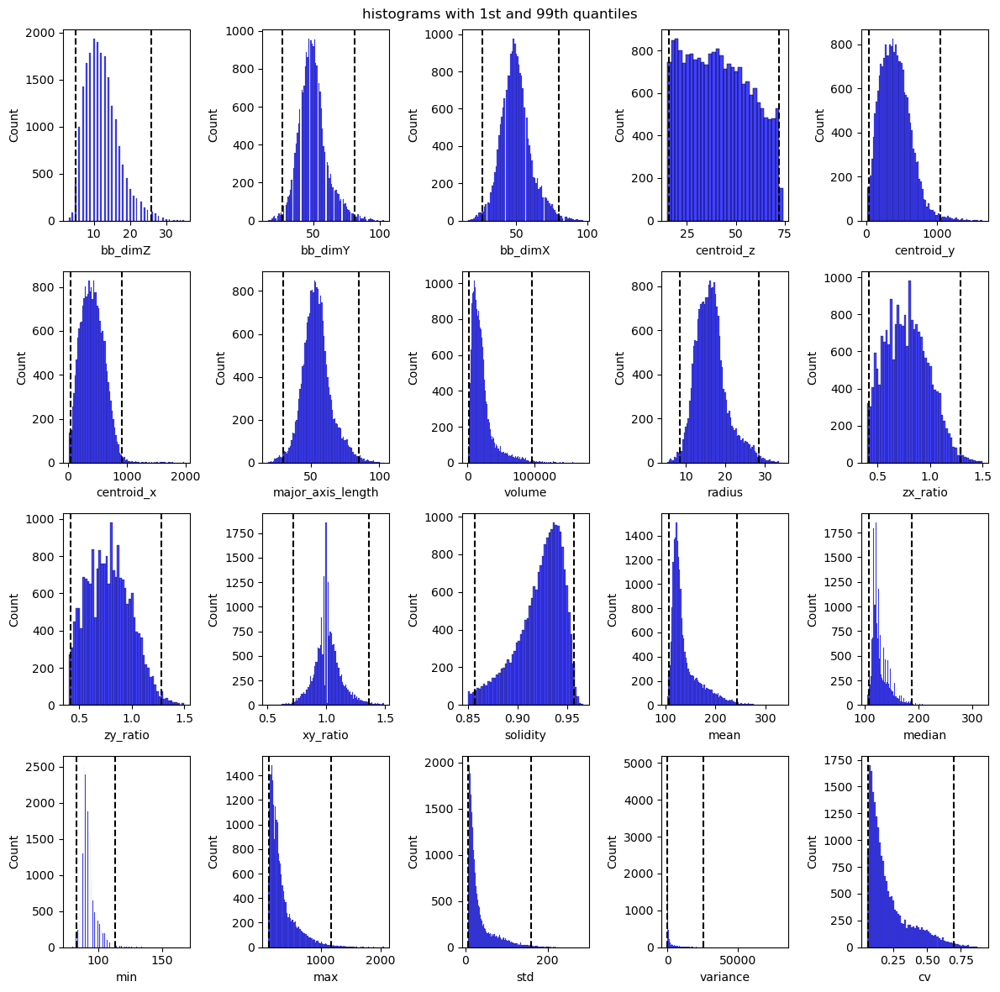

In [9]:
quantitativeVars = ["bb_dimZ", "bb_dimY", "bb_dimX", "centroid_z", "centroid_y", "centroid_x", "major_axis_length","volume", "radius", "zx_ratio", "zy_ratio", "xy_ratio", "solidity", "mean", "median", "min","max","std","variance","cv"]
histogramsOfVariables(filt,variables=quantitativeVars)

## Plot variables pairwise


In [ ]:
quantitativeVars = ["bb_dimZ", "bb_dimY", "bb_dimX", "centroid_z", "major_axis_length", "zx_ratio", "zy_ratio", "xy_ratio", "solidity", "radius","cv"]
sns.pairplot(data=filt[quantitativeVars], vars=quantitativeVars, hue="cv", plot_kws={'alpha':0.3,'s':10})
plt.show()

KeyboardInterrupt: 

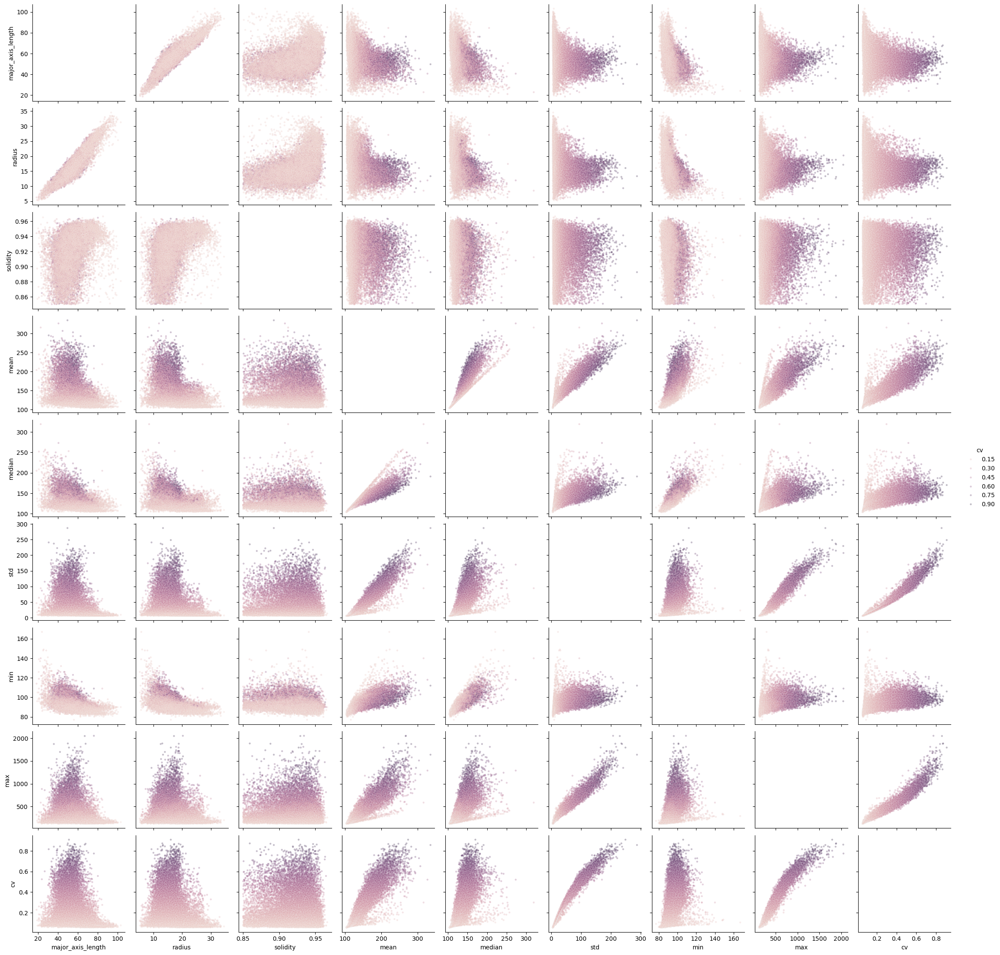

In [55]:
quantitativeVars = [ "major_axis_length","radius", "solidity", "mean", "median", "std", "min","max", "cv"]
sns.pairplot(data=filt[quantitativeVars], vars=quantitativeVars, plot_kws={'alpha':0.3,'s':10}, hue='cv')
plt.show()

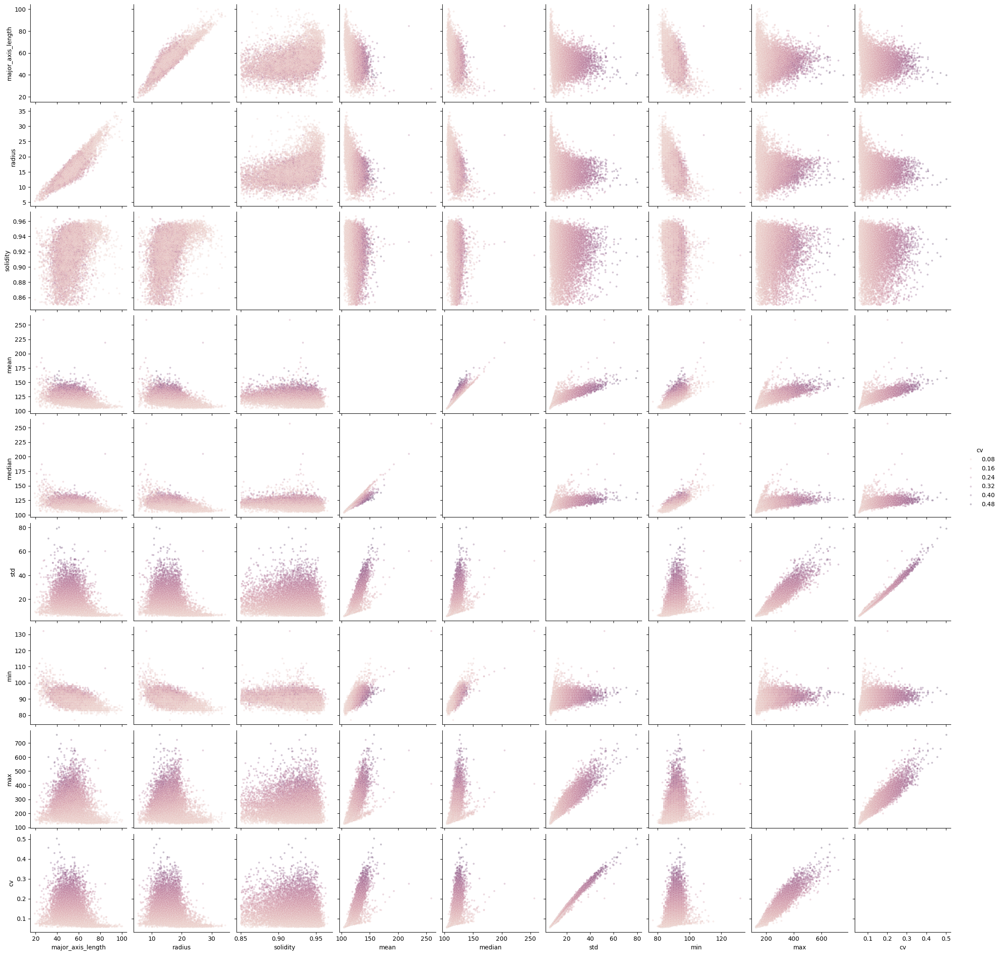

In [56]:
quantitativeVars = [ "major_axis_length","radius", "solidity", "mean", "median", "std", "min","max", "cv"]
sns.pairplot(data=filt[filt['protein']=="SDC1"][quantitativeVars], vars=quantitativeVars, plot_kws={'alpha':0.3,'s':10}, hue='cv')
plt.show()

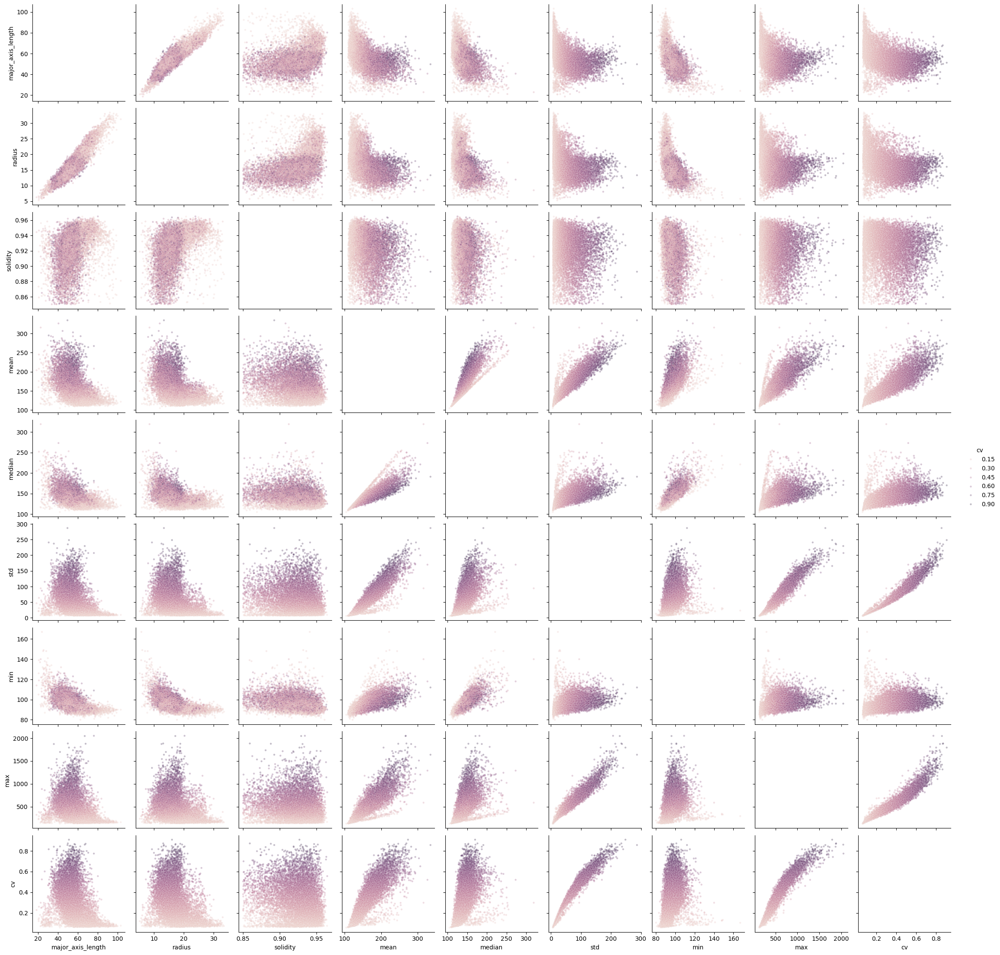

In [57]:
quantitativeVars = [ "major_axis_length","radius", "solidity", "mean", "median", "std", "min","max", "cv"]
sns.pairplot(data=filt[filt['protein']=="DPY27"][quantitativeVars], vars=quantitativeVars, plot_kws={'alpha':0.3,'s':10}, hue='cv')
plt.show()

## Final scatter/regression plots

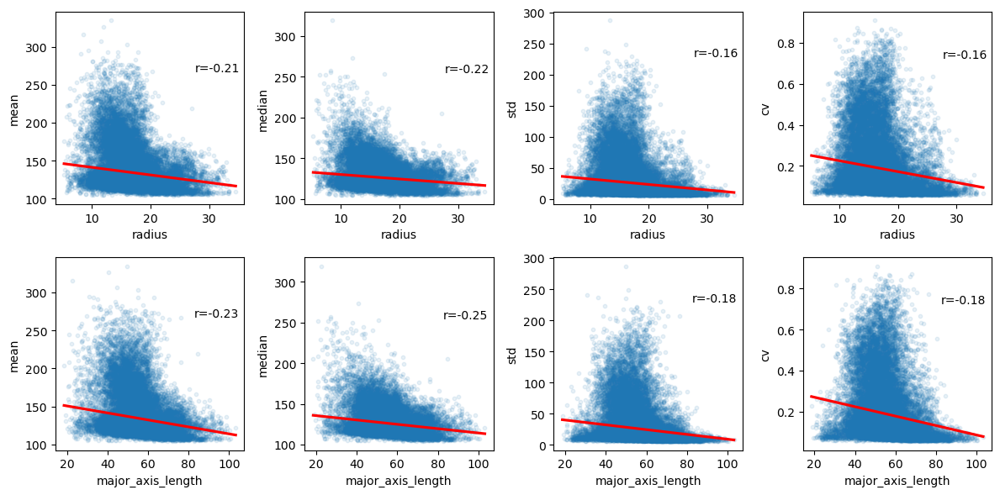

In [58]:
# filter_indeces = (df['centroid_z']>=15) & (df['solidity']>=0.85) & (df['solidity']<=1) & (df['xy_ratio']>0.5) & (df['xy_ratio']<1.5) & (df['zx_ratio']>0.4) & (df['zx_ratio']<1.5) & (df['zy_ratio']>0.4) & (df['zy_ratio']<1.5)
# filt=df[filter_indeces]
# filt=filt.reset_index(drop=True)
# filt

xVars = ['radius', 'major_axis_length']
yVars = ['mean','median', 'std', 'cv']



plotRegression(filt,xVars,yVars)

#plotScatter(filt,xVars,yVars)

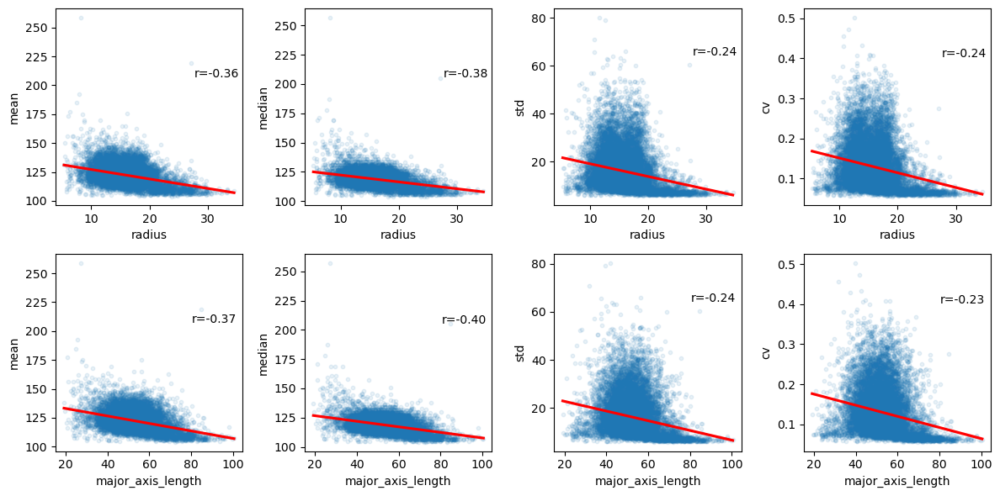

In [59]:
plotRegression(filt[filt['protein']=='SDC1'],xVars,yVars)

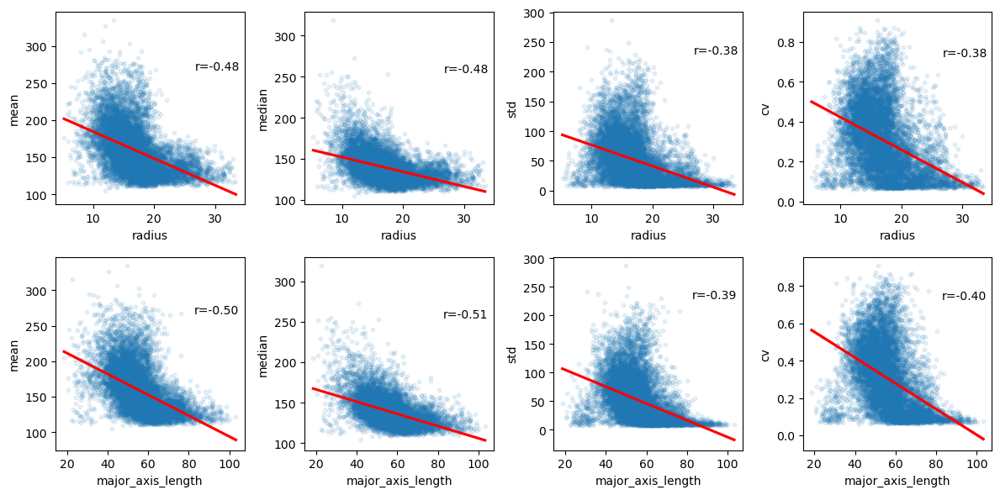

In [60]:
plotRegression(filt[filt['protein']=='DPY27'],xVars,yVars)

In [25]:
filt.head()

,label,bb_dimZ,bb_dimY,bb_dimX,centroid_z,centroid_y,centroid_x,major_axis_length,solidity,mean,median,std,sum,variance,max,min,volume,id,zproj_spots,zproj_nuclei,filename,date,experiment,strain,protein,raw_filepath,denoised_filepath,radius,cv,zx_ratio,zy_ratio,xy_ratio
0,4,13,47,42,17.885833,526.404655,261.189650,47.890527,0.919311,208.377154,160.0,116.236053,3205049,13510.819916,854,99,15381,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,15.427610,0.557816,0.990476,0.885106,0.893617
1,5,10,47,50,16.749367,537.583875,332.809957,50.926443,0.926797,179.198181,142.0,93.185448,2620415,8683.527708,720,94,14623,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,15.169897,0.520013,0.640000,0.680851,1.063830
2,6,9,44,45,16.197679,570.622426,414.887215,47.014676,0.874448,213.524055,152.0,136.668342,2281291,18678.235569,939,99,10684,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,13.663074,0.640061,0.640000,0.654545,1.022727
3,9,11,51,48,18.397786,474.739083,458.271501,53.889249,0.923223,212.819040,143.0,162.639126,3518750,26451.485337,1200,96,16534,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,15.803858,0.764213,0.733333,0.690196,0.941176
4,10,13,41,40,19.028934,573.256281,275.093179,41.563950,0.895334,196.610173,143.0,129.093455,2527817,16665.120183,873,100,12857,DPY27_3d_20240915_1268_E_bean_15um,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,20240915_1268_E_bean_15um,20240915,3d,1268,DPY27,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,/mnt/external.data/MeisterLab/Dario/Imaging/DP...,14.532835,0.656596,1.040000,1.014634,0.975610


In [42]:
dataVar='median'
nb_nuc=100
extreme_n = filt.nlargest(nb_nuc,dataVar)

#for i,index in enumerate(extreme_n.index):
filt.filename.iloc[extreme_n.index.sort_values()]

5985         20240808_1268_E_bean_15um_08
6974    20240808_1268_E_late_15um_05_dead
6975    20240808_1268_E_late_15um_05_dead
6976    20240808_1268_E_late_15um_05_dead
6977    20240808_1268_E_late_15um_05_dead
                      ...                
7139    20240808_1268_E_late_15um_05_dead
7144    20240808_1268_E_late_15um_05_dead
7159    20240808_1268_E_late_15um_05_dead
7164    20240808_1268_E_late_15um_05_dead
7172    20240808_1268_E_late_15um_05_dead
Name: filename, Length: 100, dtype: object

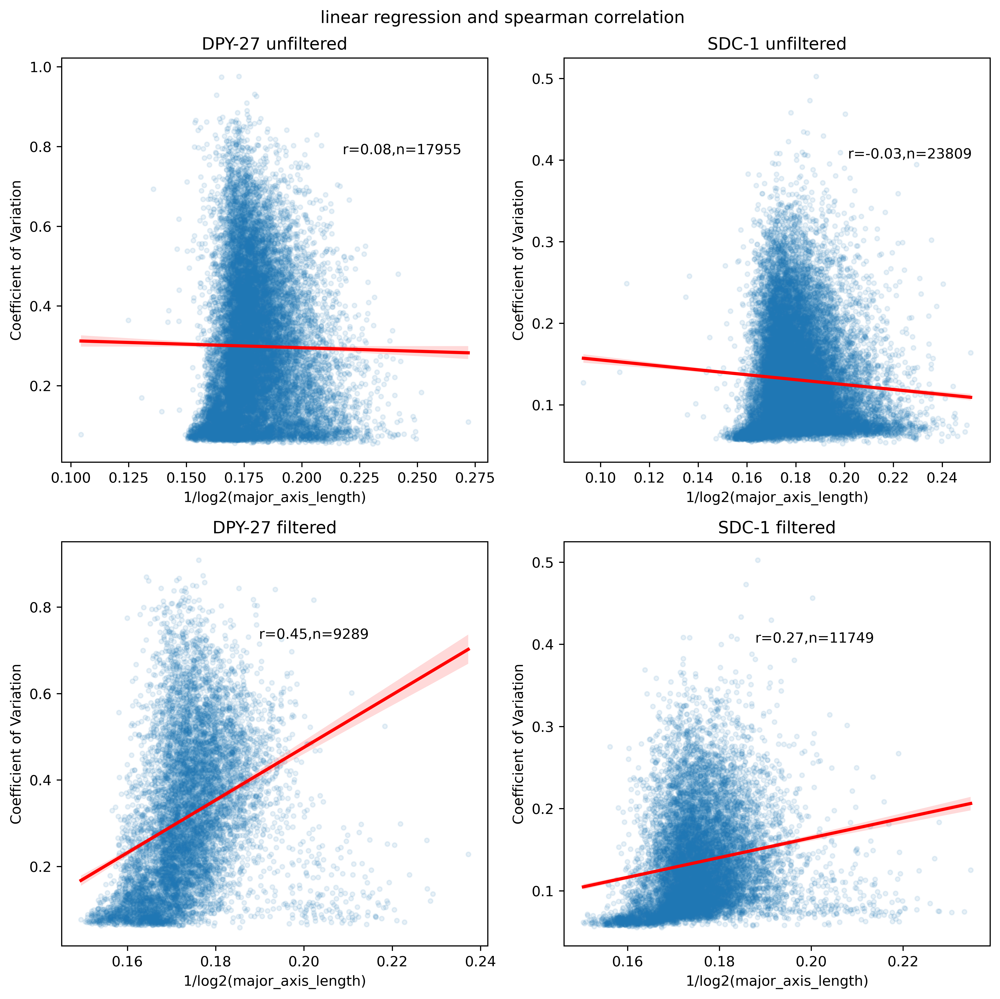

In [123]:

#filter_indeces = (df['solidity']>=0.5) 
#filter_indeces = (df['centroid_z']>=15) & (df['solidity']>=0.85) & (df['solidity']<=1) & (df['xy_ratio']>0.5) & (df['xy_ratio']<1.5) & (df['zx_ratio']>0.4) & (df['zx_ratio']<1.5) & (df['zy_ratio']>0.4) & (df['zy_ratio']<1.5)
#filter_indeces =  (df['solidity']>=0.85)  & (df['xy_ratio']>0.8) & (df['xy_ratio']<1.2) & (df['zx_ratio']>0.6) & (df['zx_ratio']<1.3) & (df['zy_ratio']>0.6) & (df['zy_ratio']<1.3)
#filter_indeces = (df['centroid_z']>=15) & (df['solidity']>=0.9) & (df['solidity']<=1) & (df['xy_ratio']>0.5) & (df['xy_ratio']<1.5) & (df['zx_ratio']>0.4) & (df['zx_ratio']<1.5) & (df['zy_ratio']>0.4) & (df['zy_ratio']<1.5)
#filt=df[filter_indeces]
#filt=filt.reset_index(drop=True)


xVar = 'inv_log_major_axis_length'
yVar = 'cv'
filt['inv_major_axis_length'] = 1/filt['major_axis_length']
filt['inv_log_major_axis_length'] = 1/np.log2(filt['major_axis_length'])
df['inv_log_major_axis_length'] = 1/np.log2(df['major_axis_length'])

ff1=df[df['protein']=='DPY27']
ff2=df[df['protein']=='SDC1']
ff3=filt[filt['protein']=='DPY27']
ff4=filt[filt['protein']=='SDC1']


fig, axs = plt.subplots(2,2,figsize = (10,10),dpi= 450)
fig.suptitle('linear regression and spearman correlation')

r, p = sp.stats.spearmanr(a=ff1[xVar], b=ff1[yVar])
#r, p = sp.stats.pearsonr(x=ff1[xVar], y=ff1[yVar])
sns.regplot(data=ff1, x=xVar, y=yVar, scatter_kws={'alpha':0.1,'s':10}, line_kws={'color':'red'},ax=axs[0,0])
axs[0,0].text(np.max(ff1[xVar])*0.8, np.max(ff1[yVar])*0.8, 'r={:.2f},n={:.0f}'.format(r,len(ff1)))
axs[0,0].set(xlabel='1/log2(major_axis_length)', ylabel='Coefficient of Variation',title='DPY-27 unfiltered')

r, p = sp.stats.spearmanr(a=ff2[xVar], b=ff2[yVar])
#r, p = sp.stats.pearsonr(x=ff2[xVar], y=ff2[yVar])
sns.regplot(data=ff2, x=xVar, y=yVar, scatter_kws={'alpha':0.1,'s':10}, line_kws={'color':'red'},ax=axs[0,1])
axs[0,1].text(np.max(ff2[xVar])*0.8, np.max(ff2[yVar])*0.8, 'r={:.2f},n={:.0f}'.format(r,len(ff2)))
axs[0,1].set(xlabel='1/log2(major_axis_length)', ylabel='Coefficient of Variation',title='SDC-1 unfiltered')

r, p = sp.stats.spearmanr(a=ff3[xVar], b=ff3[yVar])
#r, p = sp.stats.pearsonr(x=ff3[xVar], y=ff3[yVar])
sns.regplot(data=ff3, x=xVar, y=yVar, scatter_kws={'alpha':0.1,'s':10}, line_kws={'color':'red'},ax=axs[1,0])
axs[1,0].text(np.max(ff3[xVar])*0.8, np.max(ff3[yVar])*0.8, 'r={:.2f},n={:.0f}'.format(r,len(ff3)))
axs[1,0].set(xlabel='1/log2(major_axis_length)', ylabel='Coefficient of Variation',title='DPY-27 filtered')

r, p = sp.stats.spearmanr(a=ff4[xVar], b=ff4[yVar])
#r, p = sp.stats.pearsonr(x=ff4[xVar], y=ff4[yVar])
sns.regplot(data=ff4, x=xVar, y=yVar, scatter_kws={'alpha':0.1,'s':10}, line_kws={'color':'red'},ax=axs[1,1])
axs[1,1].text(np.max(ff4[xVar])*0.8, np.max(ff4[yVar])*0.8, 'r={:.2f},n={:.0f}'.format(r,len(ff4)))
axs[1,1].set(xlabel='1/log2(major_axis_length)', ylabel='Coefficient of Variation',title='SDC-1 filtered')

plt.tight_layout()
plt.show()

In [41]:
np.array(ff3[x])

array([0.1791579 , 0.17635617, 0.18001673, ..., 0.17429195, 0.15991759,
       0.17080602])

In [121]:
from sklearn.preprocessing import SplineTransformer
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import RidgeCV

# use a spline wit 4 knots and 3 degrees 
# we combine the spline with a ridge regressions
reg = make_pipeline(
                    SplineTransformer(n_knots=3, degree=3), 
                    RidgeCV()
                    )
reg.fit(np.array(ff3[xVar]).reshape(-1,1),np.array(ff3[yVar]).reshape(-1,1))

Pipeline(steps=[('splinetransformer', SplineTransformer(n_knots=3)),
                ('ridgecv', RidgeCV())])

In [127]:
splt = SplineTransformer(n_knots=4, degree=3)
splt.fit(np.array(ff3[xVar]).reshape(-1,1),np.array(ff3[yVar]).reshape(-1,1))
knots = splt.bsplines_[0].t

knots[2:-2]

array([0.12024639, 0.1494895 , 0.17873262, 0.20797574, 0.23721886,
       0.26646198])

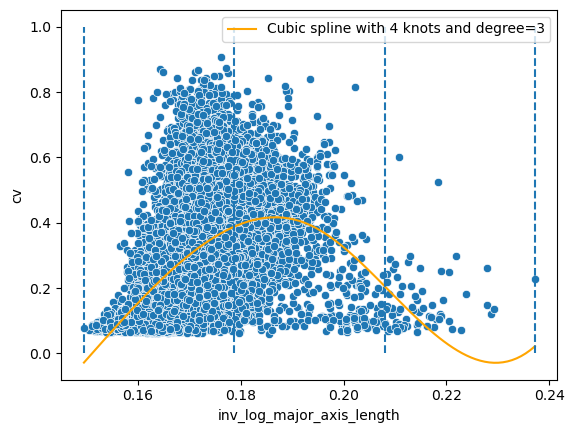

In [129]:
# Create observations
x_new = np.linspace(np.array(ff3[xVar]).min(),np.array(ff3[xVar]).max(), 100).reshape(-1,1)
# Make some predictions
pred = reg.predict(x_new)

# plot
sns.scatterplot(x=ff3[xVar], y=ff3[yVar])

plt.plot(x_new, pred, label='Cubic spline with 4 knots and degree=3', color='orange')
plt.vlines(knots[3:-3], ymin=0, ymax=1, linestyles="dashed")
plt.legend();

In [139]:
mask

array([[ True],
       [ True],
       [ True],
       ...,
       [ True],
       [ True],
       [ True]])

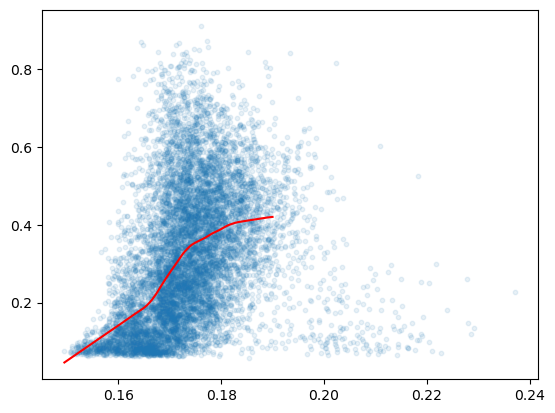

In [144]:
import statsmodels.api as sm


# Compute a lowess smoothing of the data
smoothed = sm.nonparametric.lowess(exog=x[mask].flatten(), endog=y[mask].flatten(), frac=0.3)
smoothed

fig, ax = plt.subplots()

ax.scatter(x, y,s=10, alpha=0.1)
ax.plot(smoothed[:, 0], smoothed[:, 1], c="red")
#plt.autoscale(enable=True, axis="x", tight=True)

In [92]:
import piecewise_regression
pw_fit = piecewise_regression.Fit(np.array(ff3[ff3[x]<0.19][x]), np.array(ff3[ff3[x]<0.19][y]), n_breakpoints=2)
pw_fit.summary()


                    Breakpoint Regression Results                     
No. Observations                     8871
No. Model Parameters                    6
Degrees of Freedom                   8865
Res. Sum of Squares               211.518
Total Sum of Squares              275.365
R Squared                        0.231862
Adjusted R Squared               0.231342
Converged:                           True
                    Estimate      Std Err            t        P>|t|       [0.025       0.975]
----------------------------------------------------------------------------------------------------
const               -1.60971          0.2      -8.0341      1.06e-15      -2.0025       -1.217
alpha1                11.014         1.24       8.8518      1.03e-18       8.5749       13.453
beta1                8.73489         1.83       4.7646             -       5.1412       12.329
beta2                -15.391         1.46      -10.574             -      -18.244      -12.538
breakpoint1      

'\n                    Breakpoint Regression Results                     \n====================================================================================================\nNo. Observations                     8871\nNo. Model Parameters                    6\nDegrees of Freedom                   8865\nRes. Sum of Squares               211.518\nTotal Sum of Squares              275.365\nR Squared                        0.231862\nAdjusted R Squared               0.231342\nConverged:                           True\n====================================================================================================\n====================================================================================================\n                    Estimate      Std Err            t        P>|t|       [0.025       0.975]\n----------------------------------------------------------------------------------------------------\nconst               -1.60971          0.2      -8.0341      1.06e-15      -2.0

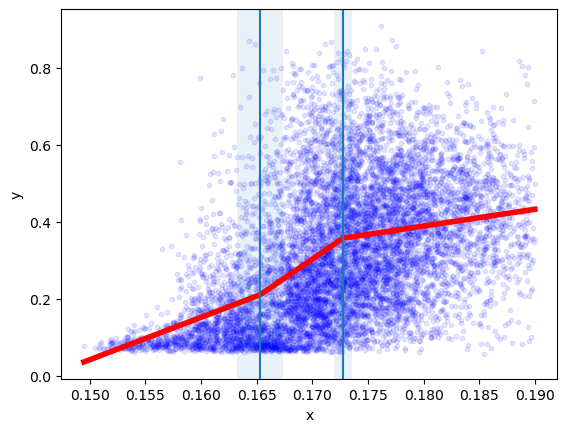

In [93]:
# Plot the data, fit, breakpoints and confidence intervals
pw_fit.plot_data(color="blue", s=10,alpha=0.1)
# Pass in standard matplotlib keywords to control any of the plots
pw_fit.plot_fit(color="red", linewidth=4)
pw_fit.plot_breakpoints()
pw_fit.plot_breakpoint_confidence_intervals()
plt.xlabel("x")
plt.ylabel("y")
plt.show()
plt.close()

KeyError: "None of [Index([ (0.1791579016742829,), (0.17635617275137827,), (0.18001672903928334,),\n        (0.1738548222002406,), (0.18596828913693236,), (0.17396578931465237,),\n       (0.17790792992760124,),  (0.1734756710932676,),  (0.1779533199521832,),\n       (0.18090599308157848,),\n       ...\n        (0.1635738024516572,), (0.16965178496563954,),   (0.163577239102024,),\n       (0.16631645910694173,),  (0.1669862962555843,), (0.17423968460231012,),\n        (0.1699389380609236,),  (0.1742919495927239,), (0.15991759073967904,),\n       (0.17080602291720048,)],\n      dtype='object', length=9289)] are in the [columns]"

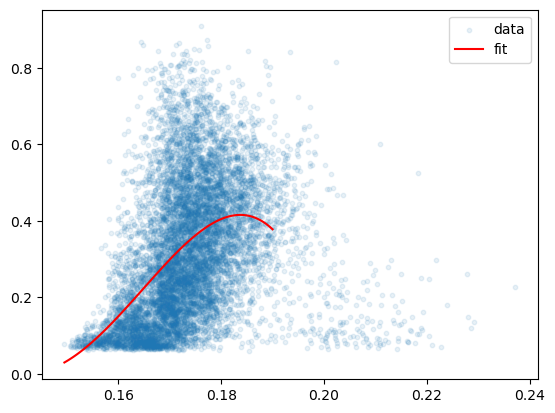

In [119]:
from matplotlib import pyplot as plt
import numpy as np
from scipy import optimize

# #fake data generation
# np.random.seed(1234)
# arr = np.linspace(0, 15, 100).reshape(2, 50)
# arr[1, :] = np.random.random(50)
# arr[1, 20:45] += 2 * arr[0, 20:45] -5
# rng = np.random.default_rng()
# rng.shuffle(arr, axis = 1)
# x_dist = arr[0, :]
# xdiff_norm = arr[1, :]

def func(x, a, b):                              
    return a * x + b      

def func(x, a, b,c,d):                              
    return a * x**4 + b*x**3  + c*x**2 + d*x


x=np.array(ff3[xVar]).reshape(-1,1)
y=np.array(ff3[yVar]).reshape(-1,1)
initialguess = [5, 3, 1,1]
mask = x<0.19
fit, covariance = optimize.curve_fit(           
        func,                                     
        x[mask],   
        y[mask],    
        initialguess)   

plt.scatter(ff3[xVar], ff3[yVar], label="data",s=10,alpha=0.1)
x_fit = np.linspace(x[mask].min(), x[mask].max(), 100)
y_fit = func(x_fit, *fit)
plt.plot(x_fit, y_fit, c="red", label="fit")
plt.legend()
plt.show()

In [ ]:
from scipy import optimize
def piecewise_linear(x, x0, y0, k1, k2):
    return np.piecewise(x, [x < x0, x >= x0], [lambda x:k1*x + y0-k1*x0, lambda x:k2*x + y0-k2*x0])

p , e = optimize.curve_fit(piecewise_linear, x, y)
xd = np.linspace(0, 15, 100)
plt.plot(x, y, "o")
plt.plot(xd, piecewise_linear(xd, *p))

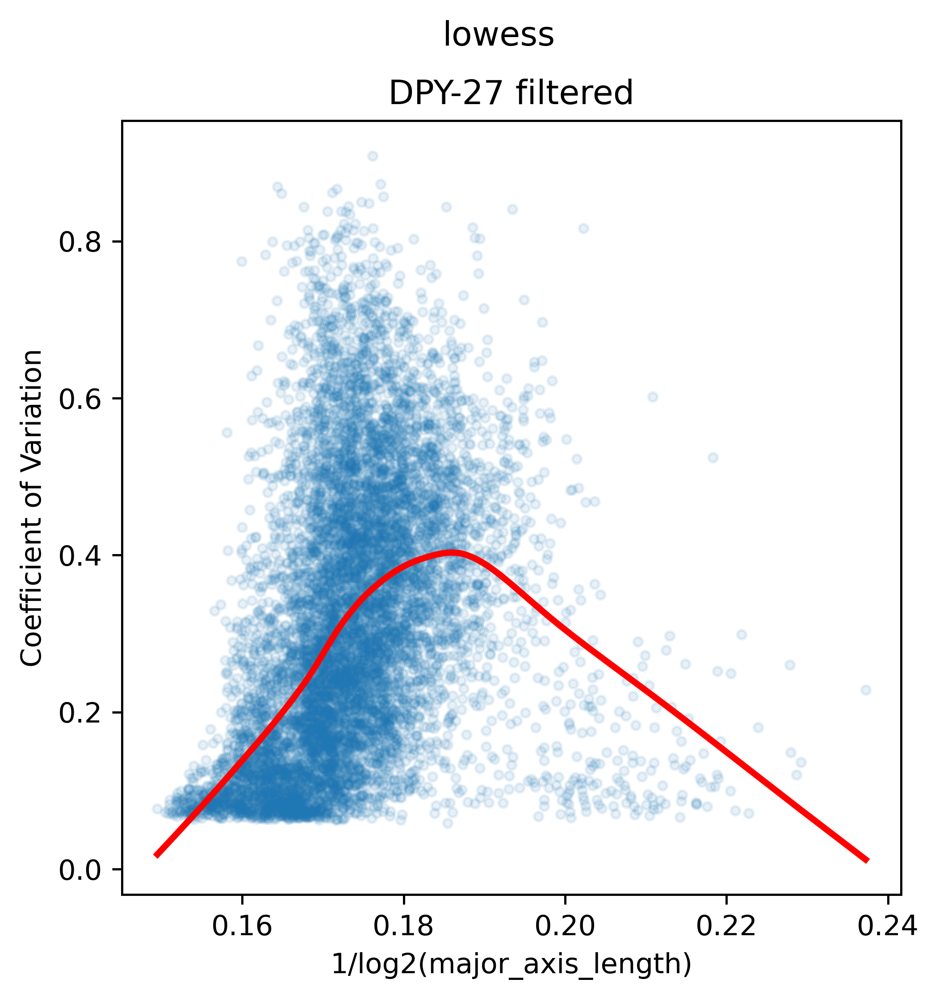

In [103]:

xVar = 'inv_log_major_axis_length'
yVar = 'cv'
filt['inv_major_axis_length'] = 1/filt['major_axis_length']
filt['inv_log_major_axis_length'] = 1/np.log2(filt['major_axis_length'])


ff3=filt[filt['protein']=='DPY27']



fig, axs = plt.subplots(1,1,figsize = (5,5),dpi= 450)
fig.suptitle('lowess')

#r, p = sp.stats.spearmanr(a=ff1[x], b=ff1[y])
#r, p = sp.stats.pearsonr(x=ff1[x], y=ff1[y])
sns.regplot(data=ff3, x=xVar, y=yVar, scatter_kws={'alpha':0.1,'s':10}, line_kws={'color':'red'},ax=axs,lowess=True,truncate=True)



axs.set(xlabel='1/log2(major_axis_length)', ylabel='Coefficient of Variation',title='DPY-27 filtered')
plt.show()

In [98]:
a=np.array([10,5,2.5,1.25])
1/np.log2(a)

array([0.30103   , 0.43067656, 0.7564708 , 3.10628372])

In [88]:
import plotly.express as px
fig = px.scatter(filt[filt['protein']=='DPY27'], x="inv_major_axis_length", y="cv", 
      hover_data={'filename': True, 'label': True, 'inv_major_axis_length': False, 'cv': False, 'centroid_z': True, 'solidity': True, 'xy_ratio': True, 'zx_ratio': True, 'zy_ratio': True, 'mean': True, 'median': True, 'std': True, 'min': True, 'max': True, 'volume': True, 'variance': True})

fig.update_layout(
  title="CV vs 1/diameter",
  xaxis_title="1/major_axis_length as proxy for age",
  yaxis_title="CV",
)


#fig.show()


ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'customdata': array([['20240915_1268_E_bean_15um', 4, 17.885833170795138, ..., 854, 15381,
                                    13510.819916246406],
                                   ['20240915_1268_E_bean_15um', 5, 16.749367434862886, ..., 720, 14623,
                                    8683.527707831034],
                                   ['20240915_1268_E_bean_15um', 6, 16.197678771995506, ..., 939, 10684,
                                    18678.23556888357],
                                   ...,
                                   ['20240809_1268_E_mid_15um_12', 104, 68.89853886616014, ..., 404,
                                    17110, 2812.660035439541],
                                   ['20240809_1268_E_mid_15um_12', 105, 70.37538779731128, ..., 376,
                                    33845, 1385.9799781529034],
                                   ['20240809_1268_E_mid_15um_12', 106, 70.00377502747646, ..., 404,
                                    20927, 1751.2022956220956]], dtype=object),
              'hovertemplate': ('filename=%{customdata[0]}<br>l' ... 'customdata[13]}<extra></extra>'),
              'legendgroup': '',
              'marker': {'color': '#636efa', 'symbol': 'circle'},
              'mode': 'markers',
              'name': '',
              'showlegend': False,
              'type': 'scattergl',
              'x': array([0.02088096, 0.01963616, 0.02126995, ..., 0.01874306, 0.01310971,
                          0.0172819 ]),
              'xaxis': 'x',
              'y': array([0.55781572, 0.52001336, 0.64006063, ..., 0.34597624, 0.28183344,
                          0.2658855 ]),
              'yaxis': 'y'}],
    'layout': {'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'title': {'text': 'CV vs 1/diameter'},
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': '1/major_axis_length as proxy for age'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'CV'}}}
})

In [ ]:

plt.figure(figsize = (30,5),dpi = 300)
#plt.ylim((0,0.25e5))
violin_plot = sns.violinplot(data=df_filt, x="group", y="mass", inner=None)
for item in violin_plot.get_xticklabels():
    item.set_rotation(90)
violin_plot.tick_params(labelsize=10)
plt.title('Mean nuclear volume (in px^3) per group')